<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

### **Assignment 1: Exploratory Data Analysis of Sentinel2 Imagery**  
**Author: Ramesh Bhatta, CIS, RIT**  
**Github Repo: https://github.com/Bhatta6190/Machine-Learning-in-Remote-Sensing.git**  

*Note: This notebook contains all the problem definition, the code block solution for each problems and the relevant explanation of results as required in a step-by-step manner.*
</div>

In [1]:
## Importing Necessary Packages

import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
import pandas as pd
import seaborn as sns

In [2]:
## Predefined plot preferences--> This is my usual plot preference

# Define text sizes
SMALL_SIZE = 14
MEDIUM_SIZE = 16
BIGGER_SIZE = 18

# Apply text size settings
plt.rc('font', size=SMALL_SIZE)          # Default font size
plt.rc('axes', titlesize=MEDIUM_SIZE)   # Axis title font size
plt.rc('axes', labelsize=MEDIUM_SIZE)   # Axis labels font size
plt.rc('xtick', labelsize=SMALL_SIZE)   # X-axis tick label font size
plt.rc('ytick', labelsize=SMALL_SIZE)   # Y-axis tick label font size
plt.rc('legend', fontsize=SMALL_SIZE)   # Legend font size
plt.rc('figure', titlesize=BIGGER_SIZE) # Figure title font size

<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

## Problem 1
We are using the 12 bands of the Sentinel-2 satellite over Rochester captured last summer:

`sentinel2_rochester.npy`

Sentinel-2 provides multispectral data across the visible, near-infrared (NIR), and shortwave-infrared (SWIR) regions. These bands come with different spatial ground sampling distances (GSD): 10 meters for B2 (Blue), B3 (Green), B4 (Red), and B8 (NIR), 20 meters for several red-edge and SWIR bands, and 60 meters for atmospheric correction bands; we will delve more into remote sensing aspects of things in week 5. For consistency and analysis, all bands have been resampled to 30 meters. The provided dataset is surface reflectance.

Plot each of the 12 Sentinel-2 bands separately, ensuring that you identify what each band corresponds to in terms of its wavelength. Use a color bar for better visualization (you can use cmcocean library for more comprehensive colormaps). What is your approach to a proper visualization in terms of stretching? You can see part of the image is considered *no data*, how would you go about that? (you will use this in the following problems as well)

`None = plot_band(args)`

</div>

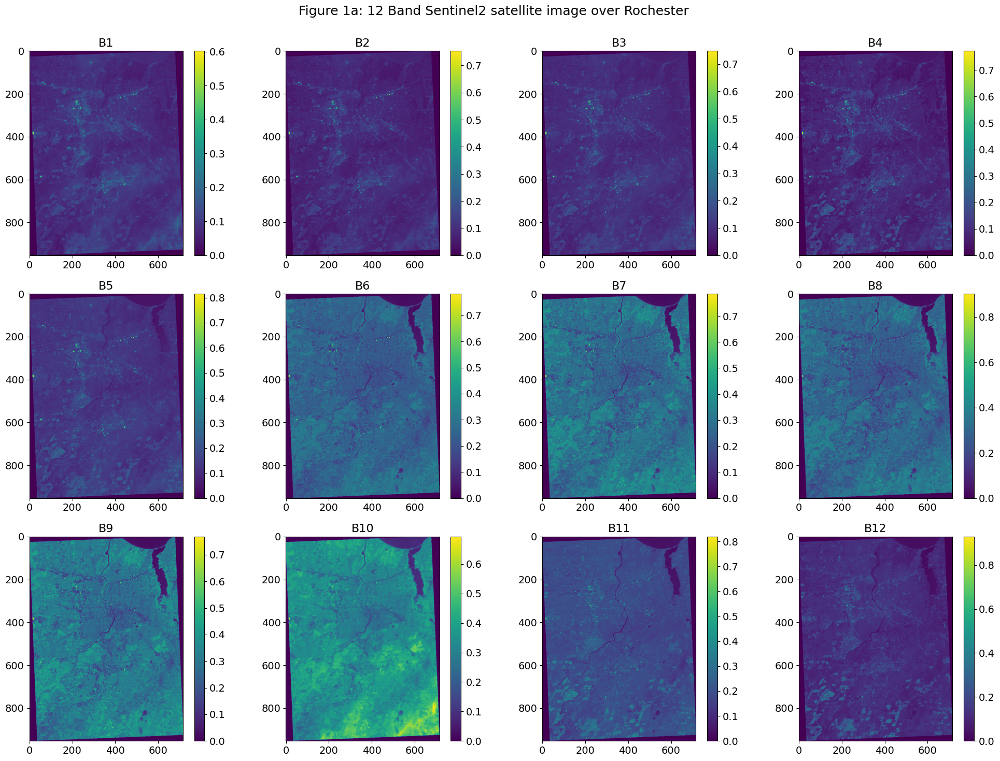

In [3]:
## 1.1 Read the sentinel2 data --> .npy format

Sen2_roc = np.load('./sentinel2_rochester.npy')

## Plot all Bands
fig, axs = plt.subplots(3, 4, figsize=(20, 15))

# For 12 Bands
for i in range(12):
    
    ax = axs[i // 4, i % 4] 
    cax = ax.imshow(Sen2_roc[:, :, i], cmap='viridis')  
    ax.set_title(f'B{i+1}')
    fig.colorbar(cax, ax=ax, orientation='vertical')

# Tight Layout
plt.suptitle('Figure 1a: 12 Band Sentinel2 satellite image over Rochester\n')
plt.tight_layout()
plt.show()

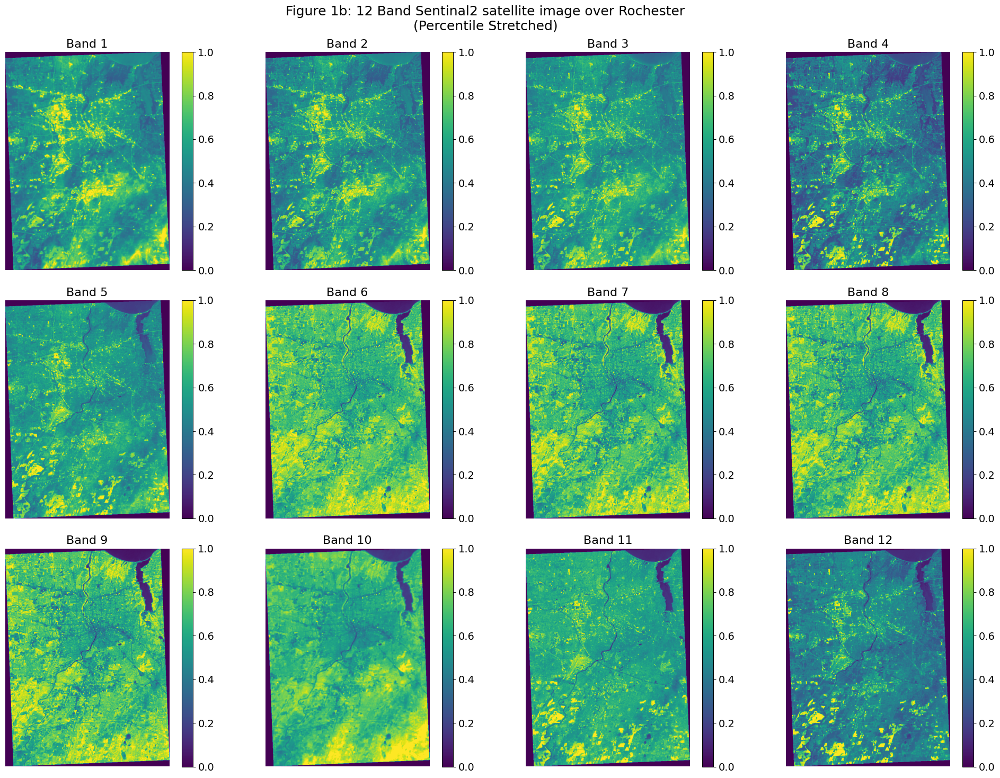

In [4]:
## 1.2 Using Percentile stretching for contrast enhancement

# Function to apply percentile stretching 
def percentile_stretch(band):
    p2, p98 = np.nanpercentile(band, (2, 98))
    band = np.clip(band, p2, p98)
    return (band - p2) / (p98 - p2)

# Plot all bands
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

# intialize stretched output bands
stretched_bands = np.zeros_like(Sen2_roc)

# Loop through the 12 bands 
for i in range(3):
    for j in range(4):
        band_idx = i * 4 + j
        if band_idx < Sen2_roc.shape[2]:  

            band = Sen2_roc[:, :, band_idx]
            
            # Band Stretching
            stretched_band = percentile_stretch(band)

            # Save the band stretched data
            stretched_bands[:, :, band_idx] = stretched_band

            # Plot each band
            ax = axes[i, j]
            cax = ax.imshow(stretched_band, cmap='viridis')  
            ax.set_title(f'Band {band_idx+1}')
            ax.axis('off')  
            fig.colorbar(cax, ax=ax, orientation='vertical')

# Tight layout
plt.suptitle('Figure 1b: 12 Band Sentinal2 satellite image over Rochester\n(Percentile Stretched)')
plt.tight_layout()
plt.show()


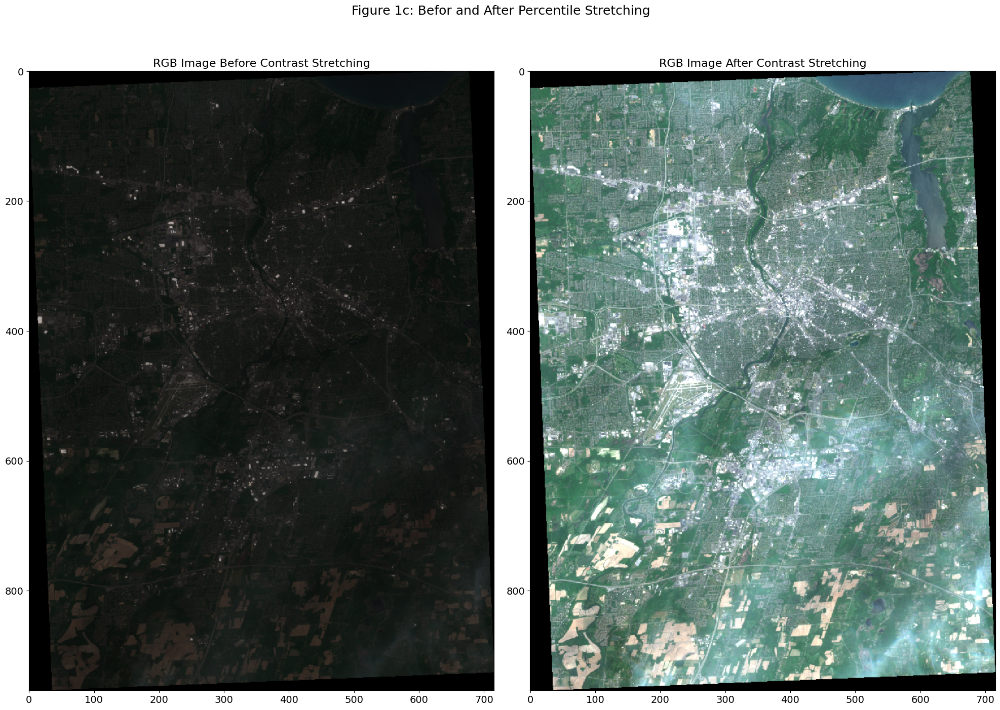

In [5]:
## 1.3 Before and After stretching

# Before stretch
b_before = Sen2_roc[:, :, 1]  
g_before = Sen2_roc[:, :, 2]  
r_before = Sen2_roc[:, :, 3]  

# Combine the bands
rgb_before = np.stack((r_before, g_before, b_before), axis=-1)

# Apply histogram stretching to the bands
b_after = stretched_bands[:, :, 1]
g_after = stretched_bands[:, :, 2]
r_after = stretched_bands[:, :, 3]

# Combine the three bands to form an RGB image after stretching
rgb_after = np.stack((r_after, g_after, b_after), axis=-1)

# Plot the Images
fig, axes = plt.subplots(1, 2, figsize=(20, 15))

axes[0].imshow(rgb_before)
axes[0].set_title("RGB Image Before Contrast Stretching")
axes[1].imshow(rgb_after)
axes[1].set_title("RGB Image After Contrast Stretching")

# Show the plot
plt.suptitle("Figure 1c: Befor and After Percentile Stretching")
plt.tight_layout()
plt.show()

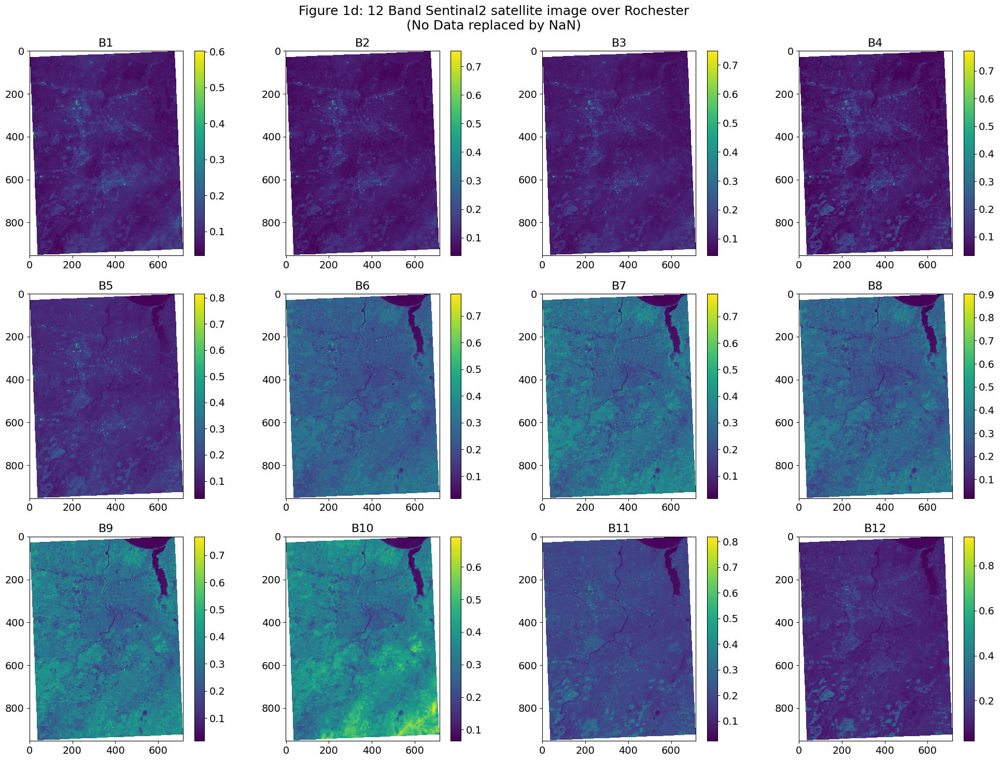

In [6]:
## 1.4 set the no data pixels (pixel with zero values to nan)

Sen2roc_nanadded = np.copy(Sen2_roc) 
Sen2roc_nanadded[Sen2_roc == 0] = np.nan  # Replace zeros with NaN 

## Plot all Bands
fig, axs = plt.subplots(3, 4, figsize=(20, 15))

# For all 12 Bands:
for i in range(12):

    ax = axs[i // 4, i % 4] 
    cax = ax.imshow(Sen2roc_nanadded[:, :, i], cmap='viridis')  
    ax.set_title(f'B{i+1}')
    fig.colorbar(cax, ax=ax, orientation='vertical')

# Tight Layout
plt.suptitle('Figure 1d: 12 Band Sentinal2 satellite image over Rochester\n(No Data replaced by NaN)')
plt.tight_layout()
plt.show()
 

<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

#### **Comments on problem 1**

For visualization purpose i used *percentile stretching* for increasing contrast for showing details in the Imagery. *Percentile Stretching* takes two cut-off percentile values- I used 2% and 98%, and then linearly scales the image such that lower percentile values maps to minimum (0) and upper percentile maps to maximum (255 for an 8 bit image). This makes the middle values in the data to be more differentiable. The results for problem 1 are explained briefely below:

-   **Figure 1a**: Shows the original 12 band image with very low contrast in all bands.  

-   **Figure 1b** : Shows the 12 band image with *percentile stretching* this makes the features more visible and differentiable in the imagery.   

-   **Figure 1c**: Shows the 3 band RGB image difference after contrast stretching. We can clearly see the difference between original RGB and high contrast RGB image. The image is more clear, with features like buildings, roads, land, vegetation and water bodies appearing clearly which was not the case in original image.  

-   **Figure 1d**: Shows the how the *no data* values are replaced by *NaN* values. This is done because, now when i process my image further these values (pixels) wont be considered for the processing and only true values (recorded data) will be used for analysis.

</div>

<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

## Problem 2

(a) Given the multispectral data for each band, define the function below that takes each
band (treated as an independent random variable) and calculates the following statistics:
mean, standard deviation (std), minimum, maximum, quartiles (Q1, median, Q3), as well
as skewness and kurtosis which was not covered in class. Explain what each of the statistics
explain.

`stats = calculate_band_statistics(args)`

(b) Define another function called to standardize the data for each band. This function
should compute the z-scores for all pixel values in the band. Explain what standardization
does to your data. Plot the histogram for each band’s original data and use the standardize
data to highlight the outliers. This approach helps to better understand the distribution of
the data and identify any anomalies present.

`data_standard = standardize(data)`

</div>

In [10]:
## 2.1(a) Band Statistics:

from scipy.stats import skew, kurtosis

def calculate_band_statistics(band_data):

    # Flatten the Band befor calculations
    flattened_band = band_data.flatten()

    # Calculate metrics
    mean = np.nanmean(flattened_band)
    std = np.nanstd(flattened_band)
    min_value = np.nanmin(flattened_band)
    max_value = np.nanmax(flattened_band)
    Q1 = np.nanpercentile(flattened_band, 25)
    median = np.nanpercentile(flattened_band, 50)
    Q3 = np.nanpercentile(flattened_band, 75)
    skewness = skew(flattened_band, nan_policy='omit')
    kurt = kurtosis(flattened_band, nan_policy='omit')

    # Return the dictionary of statistics:
    stats = {
        'mean': mean,
        'std': std,
        'min': min_value,
        'max': max_value,
        'Q1': Q1,
        'median': median,
        'Q3': Q3,
        'skewness': skewness,
        'kurtosis': kurt
    }

    return stats

## Example Usage:
Band1_stats = calculate_band_statistics(Sen2roc_nanadded[:,:,7])

print("Stats for Band 8:")
for stat, value in Band1_stats.items():
    print(f"{stat}: {np.round(value, 6)}")

Stats for Band 8:
mean: 0.291384
std: 0.080328
min: 0.0188
max: 0.903
Q1: 0.2475
median: 0.2976
Q3: 0.3464
skewness: -0.716092
kurtosis: 1.422177


<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

#### **Comments on problem 2a**

Above function calculates band statistics for Each bands of the multispectral Imagery. The Example for `Band 8 (NIR)` statistics is also shown in the output. These statistics explain following:

- **Mean:** Explains the average value of all pixels in a band. 
- **Standard deviation:** Explains the deviation of data from *Mean* of all pixels in a band.
- **Minimum:** Explains the *lowest* of all pixel values in a band.
- **Maximum:** Explains the *highest* of all pixel values in a band.
- **Q1:** is the value below which 25% of the data falls.
- **Median:** is the value below which 50% of the data falls. It is the middle value of sorted data values.
- **Q3:** is the value below which 75% of the data falls.
- **Skewness:** Measures the degree of symmetry of the distribution around its mean.
    - If skewness = 0 then the distribution is normal distribution (symmetric), 
    - If it is less than zero which is in our case it shows that left tail is longer and more values are below the mean, and 
    - If it is greater than 0 it means the right tail is longer and more values are above mean.  
    This we can see in our histogram plot of Band 8 in next section where the distribution shows to have left tail.
    
- **Kurtosis:** Kurtosis quantifies how tailed a distribution is compared to a normal distribution. It means it shows if the distribution has sharp peak or flatter peak compared to normal distribution.
    - If Kurtosis = 3, the distribution is normal.
    - If Kurtosis < 3, the distribution has flatter peaks and lighter tails.
    - If Kurtosis > 3, the distribution has sharper peaks and heavier tails.
In above case of Band 8, the kurtosis is 1.42 < 3, which indicates that our distribution has flatter peak compared to a normal distribution, which mean we have fewer extreme values in our data. 

</div>

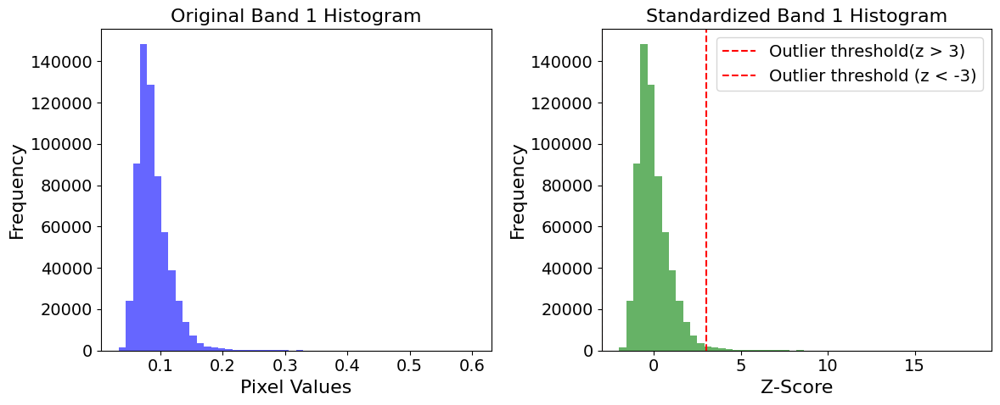

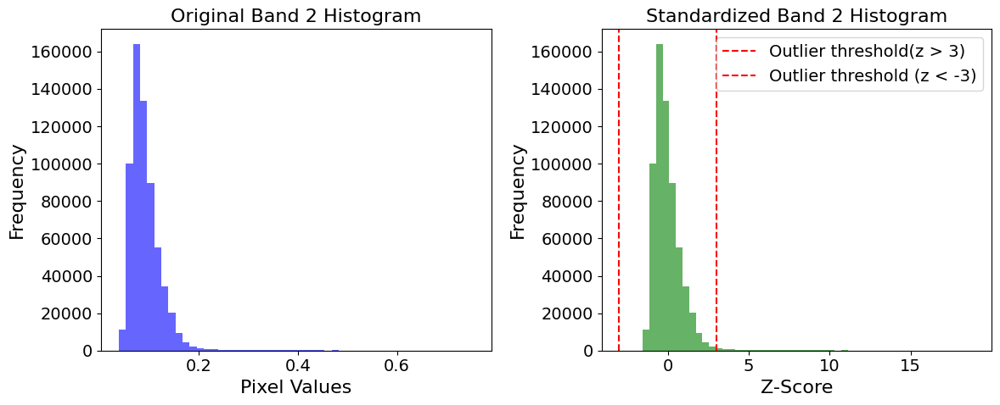

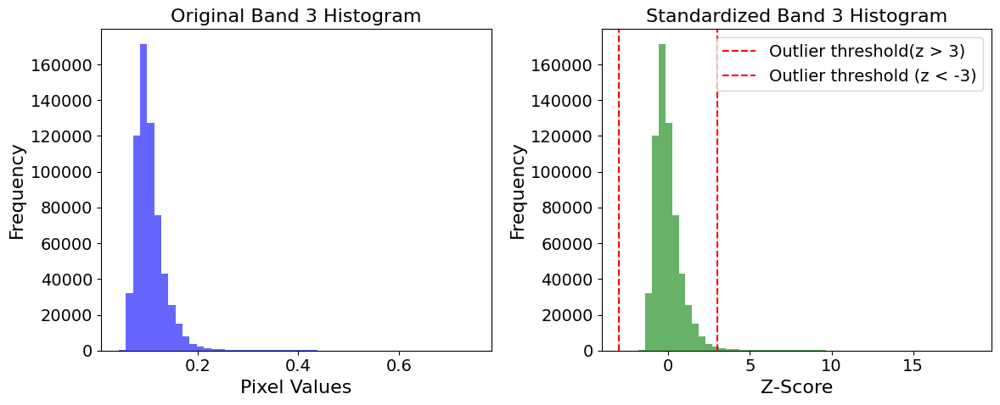

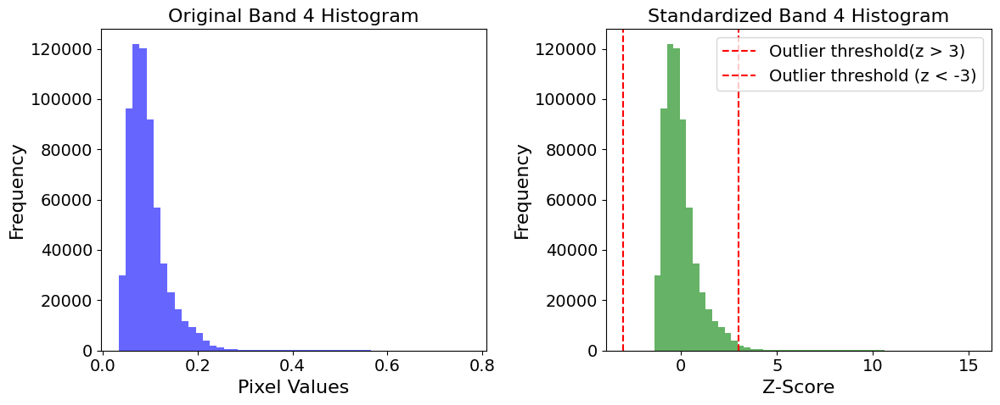

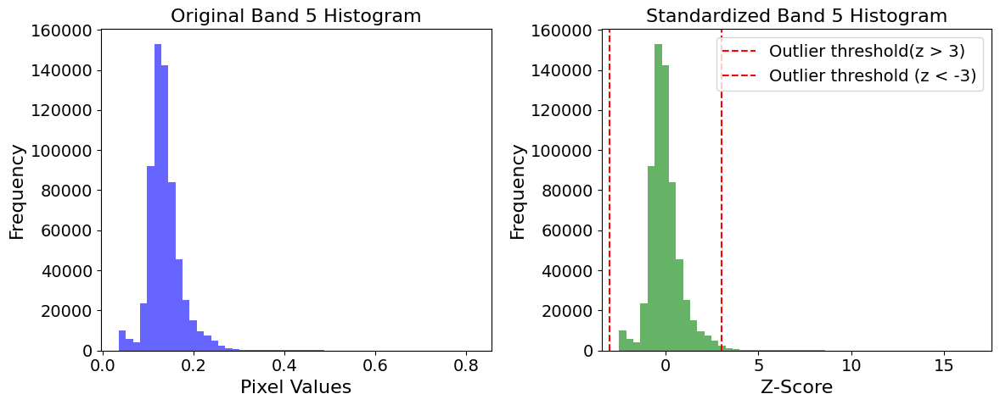

...

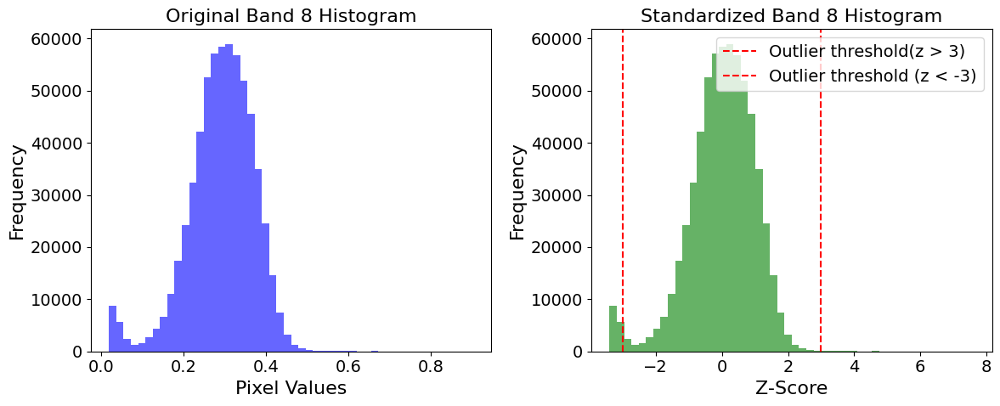

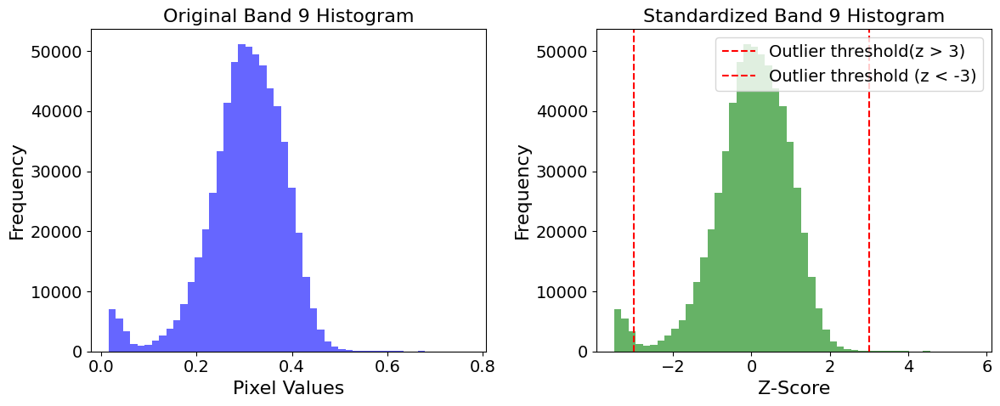

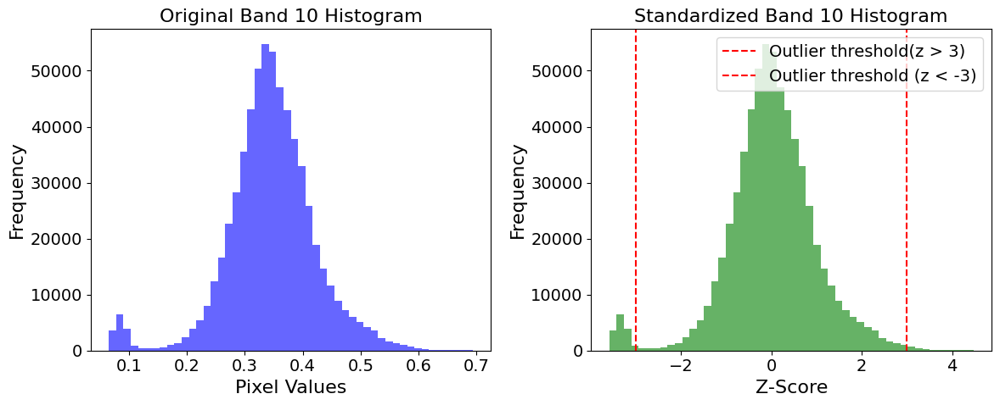

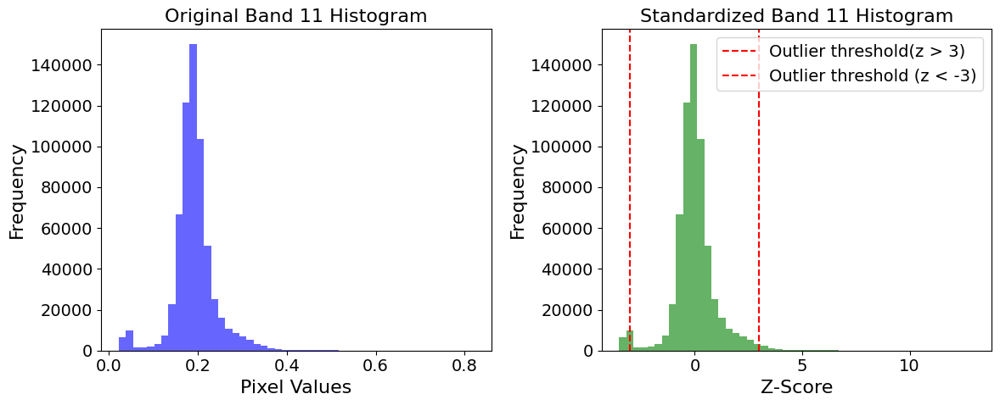

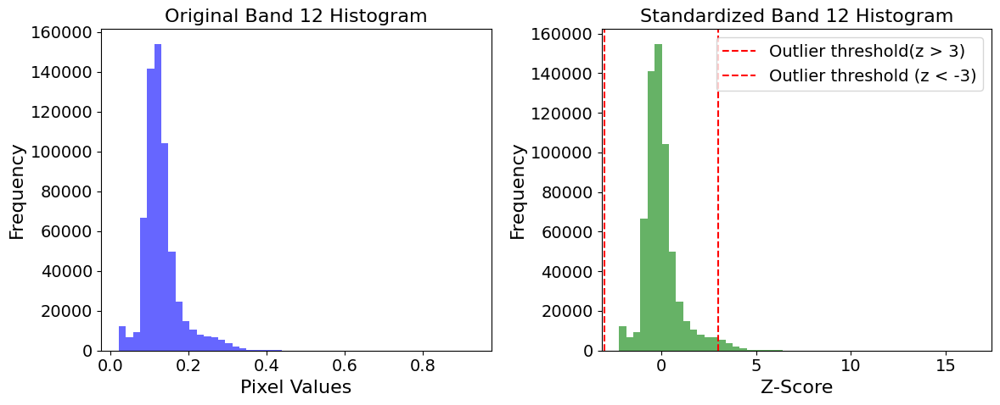

In [11]:
## 2.b Standarize the data using z-score

def standardize_band(band_data):
    """
    Standardizes single band data using z-scores
    """
    mean_val = np.nanmean(band)  
    std_val = np.nanstd(band)    
    z_scores = (band - mean_val) / std_val  

    return z_scores

## Plotting histogram for all Bandas

def plot_histograms(original_band_data, standardized_band_data, band_idx):

    fig, axs = plt.subplots(1, 2, figsize=(12, 5))
    
    # Histogram for original band data
    axs[0].hist(original_band_data.flatten(), bins=50, color='blue', alpha=0.6)
    axs[0].set_title(f"Original Band {band_idx+1} Histogram")
    axs[0].set_xlabel("Pixel Values")
    axs[0].set_ylabel("Frequency")
    
    # Histogram for standarized data
    axs[1].hist(standardized_band_data.flatten(), bins=50, color='green', alpha=0.6)
    axs[1].set_title(f"Standardized Band {band_idx+1} Histogram")
    axs[1].set_xlabel("Z-Score")
    axs[1].set_ylabel("Frequency")
    
    # Outliers are if z>3 or z<-3
    outliers = standardized_band[np.abs(standardized_band) > 3]
    axs[1].axvline(3, color='red', linestyle='--', label="Outlier threshold(z > 3)")
    axs[1].axvline(-3, color='red', linestyle='--', label="Outlier threshold (z < -3)")
    axs[1].legend()
    plt.tight_layout()
    plt.show()

# Plot for all bands both original and standarized data
for band_idx in range(Sen2roc_nanadded.shape[2]):  
    band = Sen2roc_nanadded[:, :, band_idx]
    standardized_band = standardize_band(band)
    plot_histograms(band, standardized_band, band_idx)

<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

#### **Comments on problem 2b**

 **Standarization** converts the original data distribution to a *z-score* distribution i.e mean = 0 and with certain standard deviation. This can be important when the extreme outlier values are present in the data which can affect in many *Machine Learning* modeling. We can remove ouliers by setting a boundary, which in most cases is `|z| = 3`. The histogram for each band before and after standarization is shown in the plots above. We can use the `|z| = 3` as boundary value to decide which pixel values in our band is outlier and which is not and are plotted as vertical line in the standard plots.

*Figures in section below show what each bands would pick as anamolies after setting this boundary threshold.*
</div>

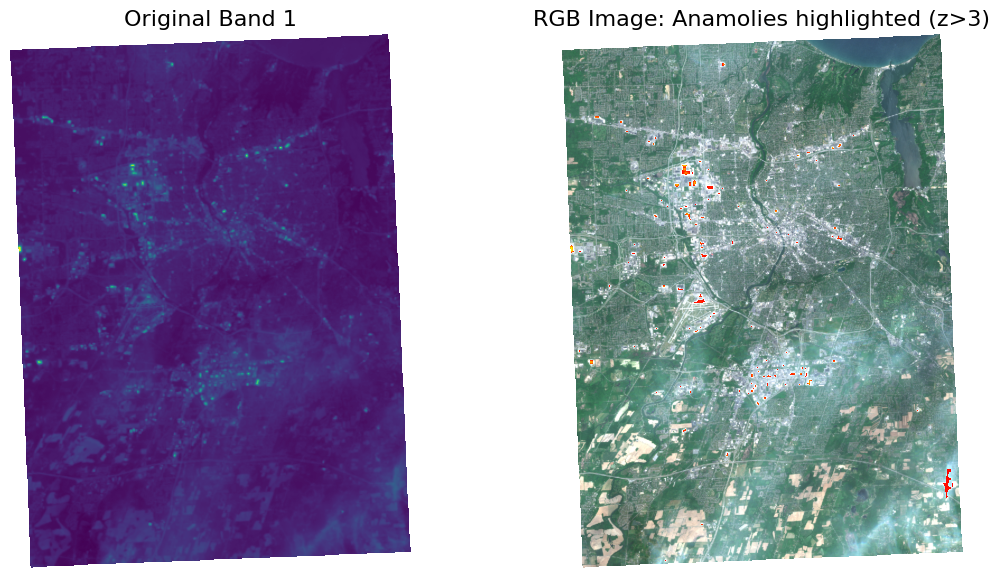

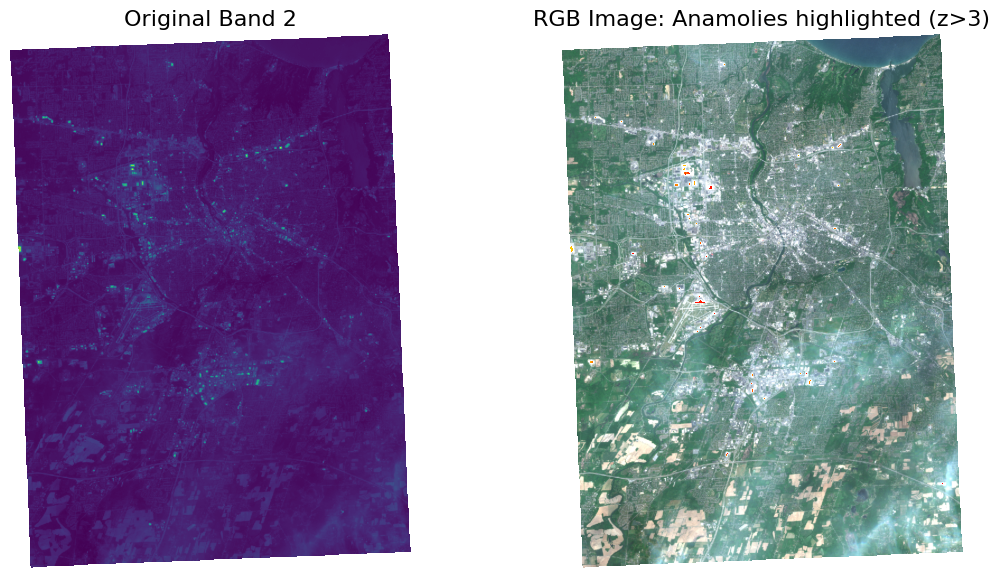

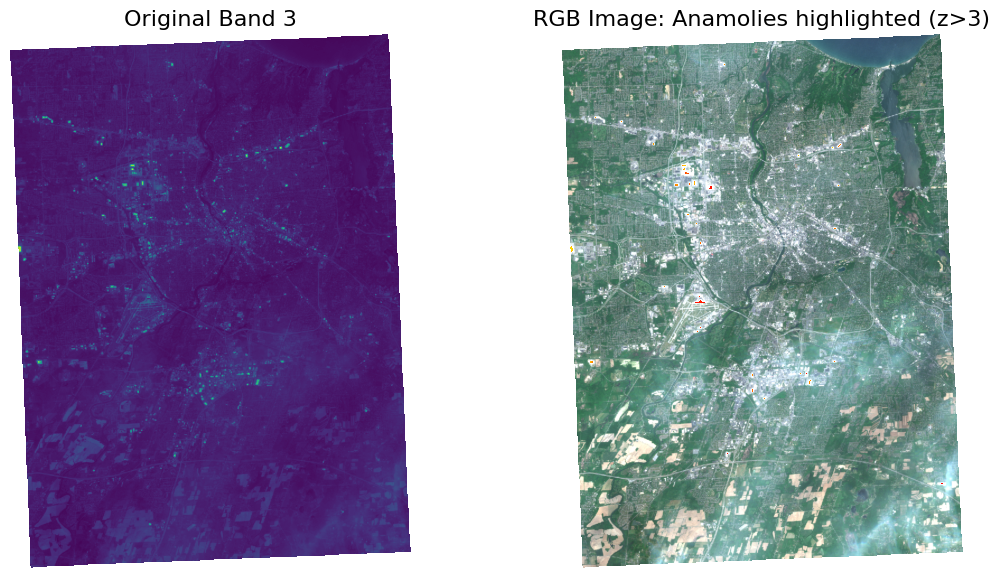

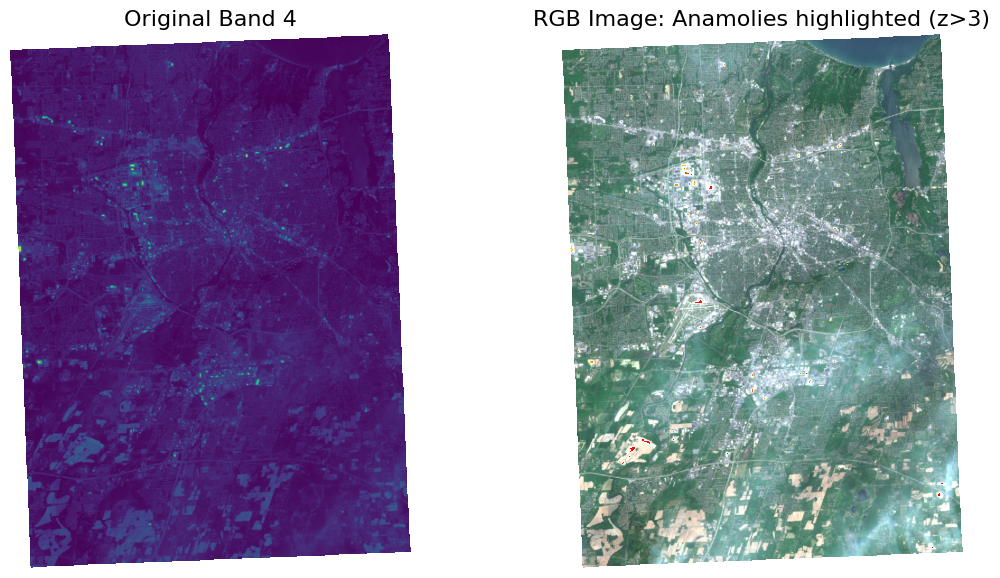

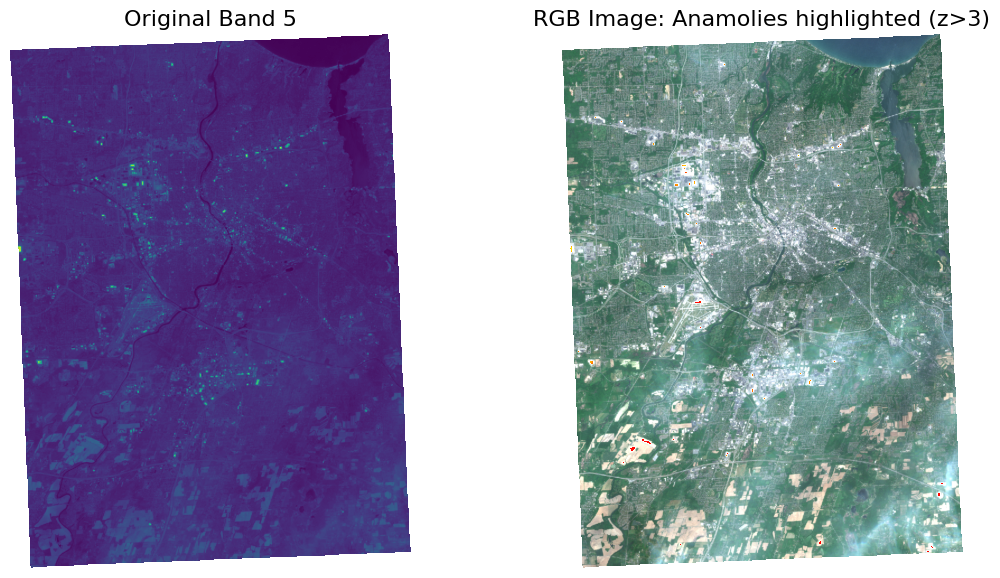

...

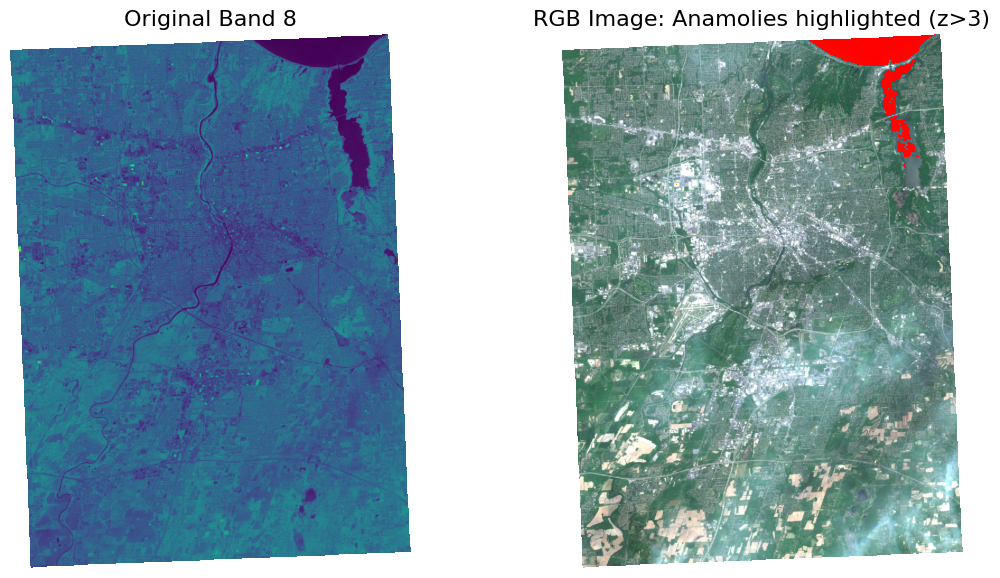

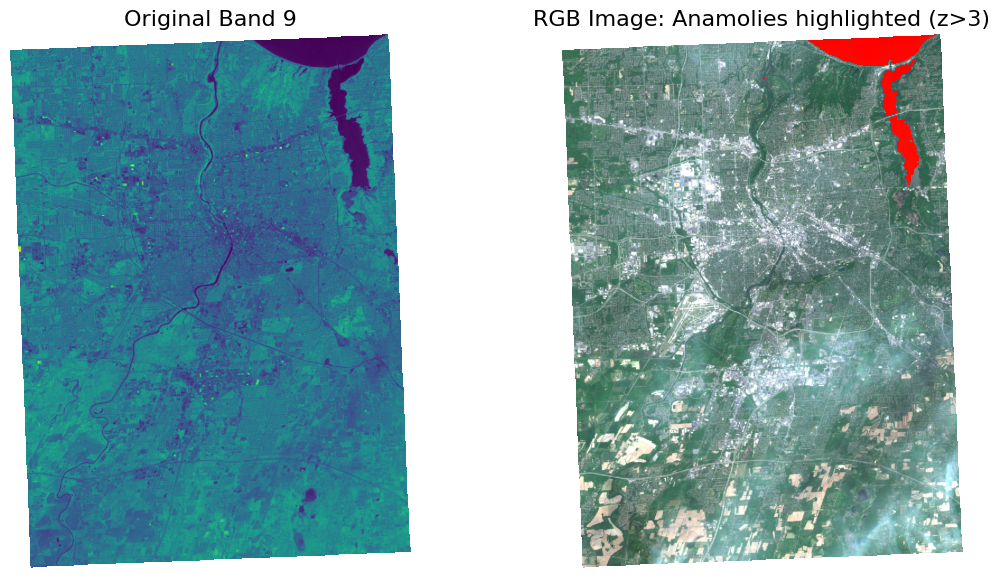

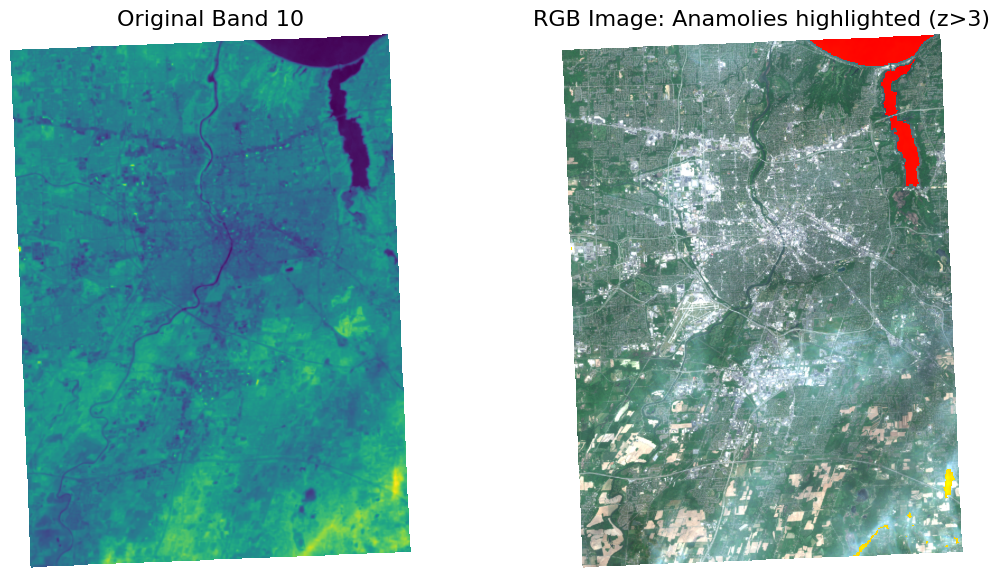

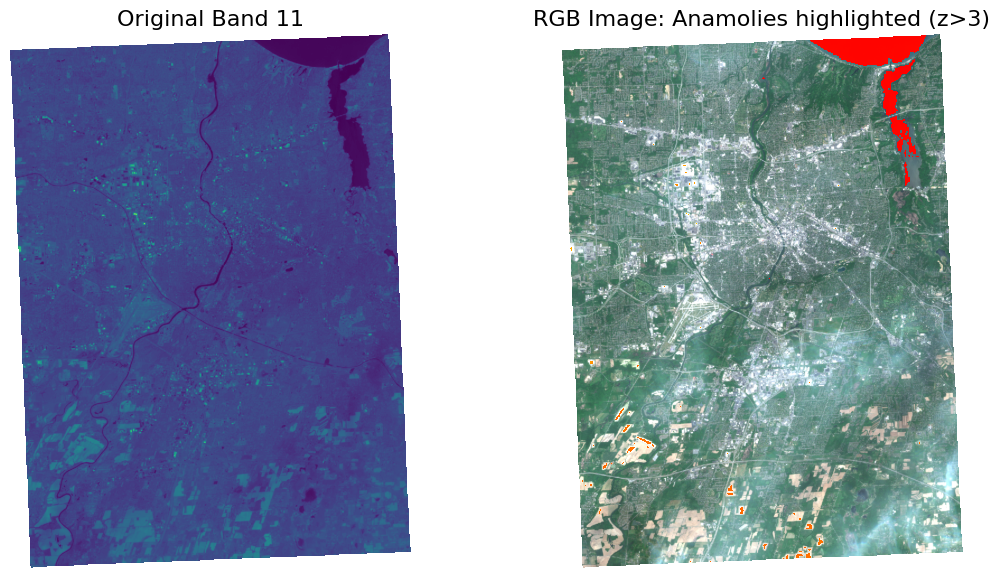

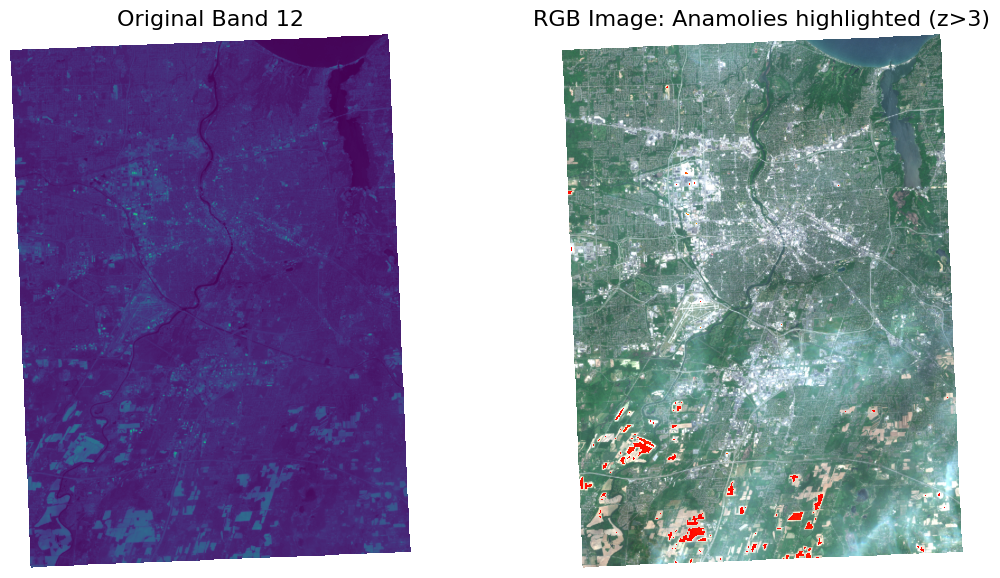

In [12]:
## 2.b contd: Example Showing Anamolies in Band Image

# Function definition
def highlight_anomalies(band_data, thresh):

    # Flatten the band and calculate z-scores
    flattened_band = band_data.flatten()
    band_zscores = standardize_band(flattened_band)
    
    # Regain original shape of the image
    zscore_reshaped = band_zscores.reshape(band_data.shape)
    
    # Masking the anamolies (absolute z-score > some threshold)
    mask = np.abs(zscore_reshaped) > thresh

    return mask

# Example visualization: Showing outliers for all bands
thresh = 3

for i in range(12):
    band = Sen2roc_nanadded[:, :, i] 
    anomaly_mask = highlight_anomalies(band, thresh)  # threshold of 3 (outlier)

    # Plot the ouliers
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Original band
    axes[0].imshow(band, cmap='viridis')
    axes[0].set_title(f"Original Band {i+1}")
    axes[0].axis('off')

    # Anomalies Highlighted RGB image
    anomalous_band = np.ma.masked_where(~anomaly_mask, band)  # Mask non-anomalous pixels
    rgb_after[Sen2_roc[:,:,i] == 0] = np.nan
    axes[1].imshow(rgb_after)
    axes[1].imshow(anomalous_band, cmap='autumn', alpha=1)  # Highlight outliers in red
    axes[1].set_title(f"RGB Image: Anamolies highlighted (z>{thresh})")
    axes[1].axis('off')
    plt.tight_layout()
    plt.show()


<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

#### **Anamolies in the Bands**
We can see in the plots above showing *anamolies* for each band that, there are not much pixels that appear as anamoly in the bands earlier bands. *Anamolies* are best seen in later bands where *Bands 6-11* show *water bodies* as anamolies in the distibution. *Band 11 and 12* show the unique anamoly i.e *bare soil patches* in the imagery. This is because *Band 11 and 12* are SWIR bands and have high reflectances as seen in Sentinel2 Imagery. Since they have relatively high reflectance than other pixels and cover less area (pixels) in whole image, they appear as outlier (right tail) in the imagery. Thus standarization can help in determining outliers in the distribution.
</div>

<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

## Problem 3

(a) We aim to explore the relationships between variables in the multispectral data. First,
use the concept of the Pearson rcorrelation coefficient, as discussed in class, to compute the
correlation matrix for all bands. Plot this matrix as an image, where each cell represents
the correlation between two bands. What type of matrix is this? Analyze the relationships
between variables and describe what the correlation coefficients reveal about their linear
relationships.

`corr_matrix = correlation_matrix(args)`

(b) For the 10-meter bands (B2, B3, B4, and B8), define a function that creates two subplots:
the first displaying a pairwise scatter plot between every two vectors, and the second showing
the density of scatter plot points in the scatter plot. The density plot is particularly useful for
visualizing areas where data points are more concentrated (there is more than one technique
to this; pick your favorite). Analyze the observed patterns and describe any significant trends
or clusters in the data.

`corr_matrix = correlation_plot(args)`

</div>

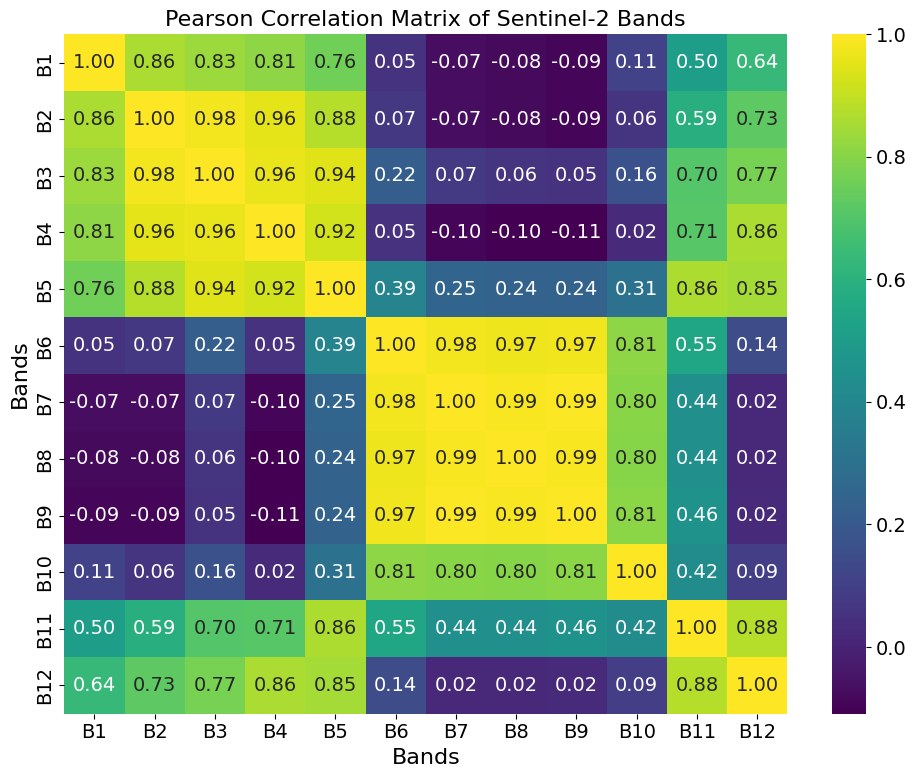

In [10]:
## 3.a Exploring Variable Relationships 
 
# Pearson correlation matrix:

def correlation_matrix(band_data):

    bands = band_data.shape[2]
    reshaped_data = band_data.reshape(-1, bands)  # Flatten rows and columns, keeping bands
    reshaped_data = reshaped_data[~np.isnan(reshaped_data).any(axis=1)]  # Remove NaN rows
    corr_matrix = np.corrcoef(reshaped_data, rowvar=False)
    return corr_matrix

# Compute the correlation matrix for Sentinel-2 data
correlation_matrix = correlation_matrix(Sen2roc_nanadded)

# Plot the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="viridis", cbar=True,
            xticklabels=[f'B{i+1}' for i in range(Sen2roc_nanadded.shape[2])],
            yticklabels=[f'B{i+1}' for i in range(Sen2roc_nanadded.shape[2])])
plt.title("Pearson Correlation Matrix of Sentinel-2 Bands")
plt.xlabel("Bands")
plt.ylabel("Bands")
plt.tight_layout()
plt.show()

<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

#### **Comments on problem 3a**

The code above in section 3a can be used to determine the correlation between each bands and plot as the correlation matrix. The plot above shows the correlation matrix for our Sentinel2 data. Analysing the plot we can see the first 5 Band pairs *(B1-B5)* are highly correlated with each other (correlation > 75%). Also the Band pairs (B6-B10) and (B11-B12) show significant correlations. This analysis can help in choosing bands with less correlation for our *Machine-Learning* models, because highly correlation bands present *data-redundancy* in our model. Choosing the uncorrelated bands reduces the computation and data requirement and makes model more robust. However one thing to be noted is that the correlation measure we used here is *Pearson Correlation Coefficient* which measures the linear correlation between bands and sometimes if the bands have non-linear correlations it might not be a best standalone measure. However this can be used as a first step in feature selection for *ML* models.

</div>

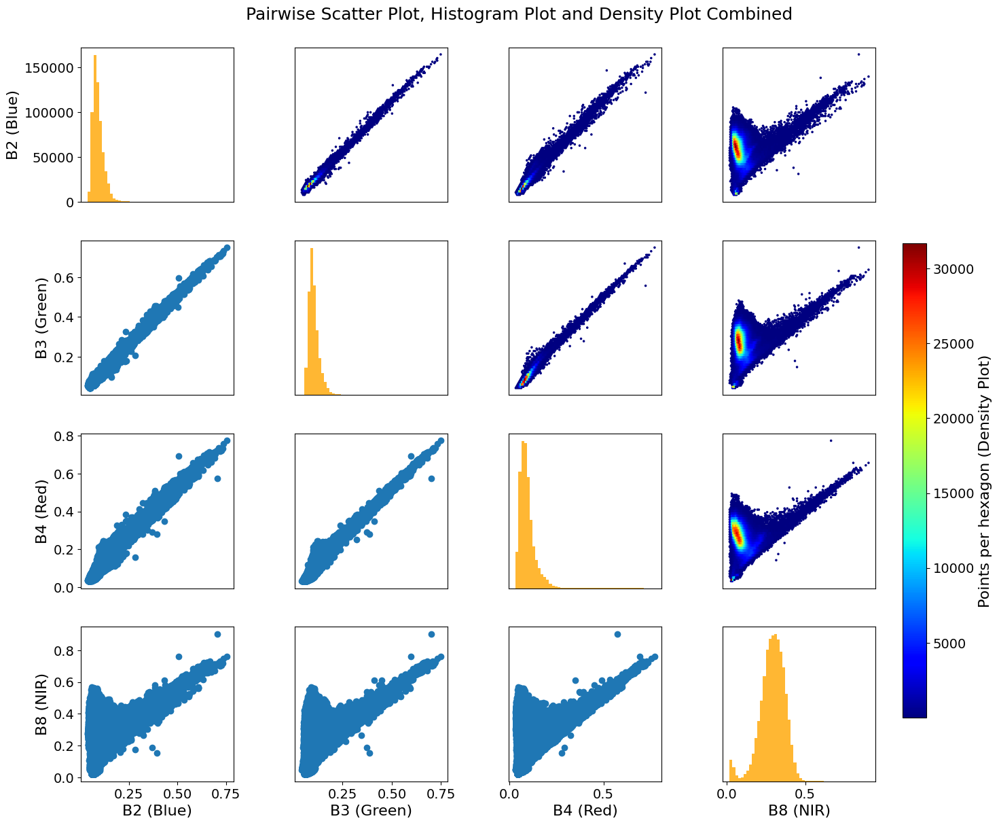

In [11]:
## 3b. Scatter and Density plot

def correlation_plot(band_data, band_names):

    num_bands = len(band_data)
    fig, axes = plt.subplots(num_bands, num_bands, figsize=(15, 15))
    fig.suptitle("Pairwise Scatter Plot, Histogram Plot and Density Plot Combined", y=0.96)

    density_plots = []

    ## For all Bands
    for i in range(num_bands):
        for j in range(num_bands):
            ax = axes[i, j]

            # Plot Histogram in Diagonal
            if i == j:
                ax.hist(band_data[i], bins=50, color='orange', alpha=0.8)

            # Density plot in upper triangle--> Using histogram based density plot (hexbin plot)
            elif i < j:
                x = band_data[i]
                y = band_data[j]
                
                # Hexbin density plot
                hb = ax.hexbin(x, y, gridsize=100, cmap='jet', mincnt=1) ## 100 hexagonal grids
                density_plots.append(hb)    # For combined color bar
                
                # Set axis off for clear visuals
                ax.set_xticks([])
                ax.set_yticks([])

            # Scatter Plot in Lower Triangle
            elif i > j:
                ax.scatter(band_data[j], band_data[i])

            # Cleaner Visuals
            if j != 0:
                ax.set_yticks([])
            if i != num_bands - 1:                 ## Remove ticks
                ax.set_xticks([])

            if i == num_bands - 1:
                ax.set_xlabel(band_names[j])       ## Name/Label only on
            if j == 0:
                ax.set_ylabel(band_names[i])
                
    if density_plots:
        cbar = fig.colorbar(density_plots[0], ax=axes, orientation='vertical', fraction=0.03, pad=0.05)
        cbar.set_label('Points per hexagon (Density Plot)')

    fig.subplots_adjust(hspace=0.25, wspace=0.4, top=0.92, bottom=0.20, left=0.07, right=0.85)
    plt.show()


# Extracting and cleaning the 10m bands
B2 = Sen2roc_nanadded[:, :, 1].flatten()
B3 = Sen2roc_nanadded[:, :, 2].flatten()
B4 = Sen2roc_nanadded[:, :, 3].flatten()
B8 = Sen2roc_nanadded[:, :, 7].flatten()

# Removing NaNs
B2_clean = B2[~np.isnan(B2)]
B3_clean = B3[~np.isnan(B3)]              
B4_clean = B4[~np.isnan(B4)]
B8_clean = B8[~np.isnan(B8)]

# Prepare data and labels
band_data = [B2_clean, B3_clean, B4_clean, B8_clean]
band_names = ["B2 (Blue)", "B3 (Green)", "B4 (Red)", "B8 (NIR)"]

# Calling the function
correlation_plot(band_data, band_names)

<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

#### **Comments on problem 3b**

The code above in section 3b can be used to determine the *Scatter-plot* and *Density-Plot* between different bands *[B2(blue), B3(green), B4(red) and B8(NIR)]*. Each plot is explained below:

- **Scatter-Plot:** Scatter plot is used to see the relation between two band data. This can be used to show how values in each band vary compared with other band. As we can see the VIS bands (B2, B3 and B4) show a high linear correlation as they can be seen to be *proportional* to each other. However the NIR band (B8) shows a unique concentration of pixels at lower values with other bands. Analysing the *Red-NIR* bands, the regions where there is **low NIR and low Red** concentation of points corresponds to **wet** regions in the image. Similarly, the regions where there is **high NIR and low Red** concentation of points corresponds to **vegetation** dominated regions in the imagery and the regions where there is **low NIR and high Red** concentation of points corresponds to **dry-soil** dominated regions in the imagery. 

- **Density-Plot:** This plot shows the concentration or density of points in the scatterplot. Since most of the region in our imagery is dominated by vegetation pixels, the relative higher density is at **High NIR and low Red, Blue, Green** values because vegetation has high reflectance in NIR bands compared to all other bands.

*Note: The NIR Vs Red distribution we see here is the famous **Tasseled Cap** distribution used in vegetation analysis using spectral remote sensing.* 

</div>

<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

## Problem 4

Visit [JPL Spectral Library](https://speclib.jpl.nasa.gov/library). ECOSTRESS data provides high-resolution lab-based spectral
reflectance across the electromagnetic spectrum, this data will be compared with the Sentinel-
2 data. Download spectral data covering the 0.35–2.5 micron wavelength range for the
two materials below:

1. Oak (Quercus genus) under the vegetation category.
2. Construction Asphalt or Road under the manmade category.

The spectral library data must be spectrally downsampled to the Sentinel-2 bands ([Sentinel-
2 bands](https://gisgeography.com/sentinel-2-bands-combinations/)). Use the concept of cosine similarity to identify the first 100 pixels in Sentinel-2
data that have the lowest spectral angle (the obtained angle in the cosine similariy) when
compared to the ECOSTRESS samples. Plot the spectra of the 1st, 50th, and 100th clos-
est matches alongside the original ECOSTRESS spectra. Analyze how closely the matches
resemble the ECOSTRESS data and explain the similarities or differences. Pick a cut off
angle and use that as a threshold to grab all the vegetation/road pixels in your sentinel-2
imagery. Represent the pixels you have identified in the image with your favorite approach.
angle = sam(v1, v2)

Notes:

- Exclude sentinel 2 bands affected by atmospheric water absorption and aerosols (443
nm, 940 nm).
- Sentinel 2 Band 10 is excluded from the data.
- Divide the ECOSTRESS reflectance data by 100 as the range is 0-100.

</div>

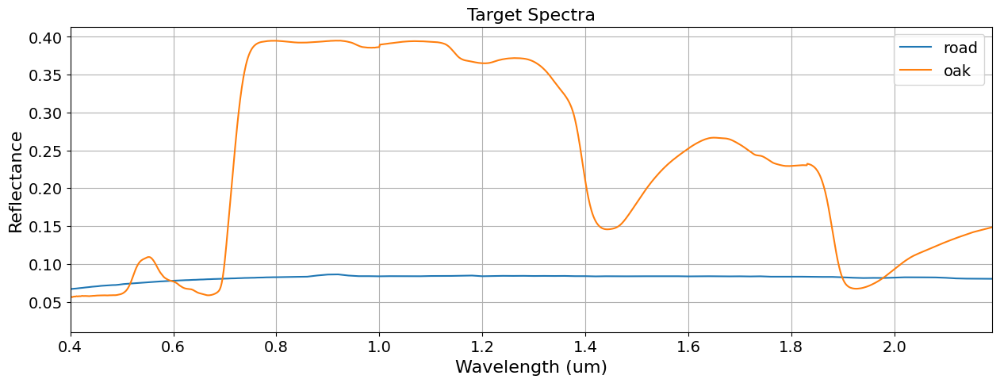

In [12]:
## 4.a Target Spectrum Import:

# There is no 1375nm band (band 10) in the data if i understand the notes correctly
# So, available bands after removing atmospheric water absorption and aerosols (443nm (B1) and 940nm (B9) bands) are:

Sentinel2_bands = [0.490, 0.560, 0.665, 0.705, 0.740, 0.783, 0.842, 0.865, 1.610, 2.190] ## VIS-to-SWIR (microns)

# And filtering the imagery for these bands the image with remaining bands is:
Sentinal_image_filtered = np.delete(Sen2roc_nanadded, [0, 9], axis=2)

# Read the Oak and Road reflectance data
road = pd.read_csv('construction_asphalt.txt', delimiter='\t', skiprows=2, names=['wavelength', 'reflectance'])
oak = pd.read_csv('quercus_agrifolia.txt', delimiter='\t', skiprows=2, names=['wavelength', 'reflectance'])

## convert to absolute reflectance from percentage reflectance
road['reflectance'] = road['reflectance']/100
oak['reflectance'] = oak['reflectance']/100

## Plot the Spectra
plt.figure(figsize=(15,5))
plt.plot(road['wavelength'],road['reflectance'], label='road')
plt.plot(oak['wavelength'], oak['reflectance'], label = 'oak')
plt.xlabel('Wavelength (um)')
plt.ylabel('Reflectance')
plt.title('Target Spectra')
plt.grid(which='both')
plt.xlim(0.4, 2.19)
plt.legend()
plt.show()

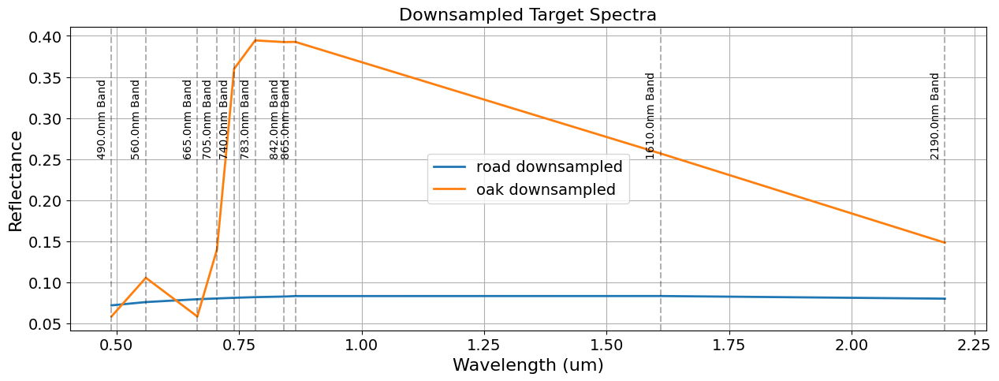

In [14]:
## 4.b Downsampling the reflectances of Target spectrum to match the sentinal 2 bands

def downsample_wavelengths(wavelengths, reflectance, sentinel_bands):

    return np.interp(sentinel_bands, wavelengths, reflectance)

# Downsample Road and Oak reflectances
road_downsampled = downsample_wavelengths(road['wavelength'], road['reflectance'], Sentinel2_bands)
oak_downsampled = downsample_wavelengths(oak['wavelength'], oak['reflectance'], Sentinel2_bands)

# Plot the downsampled spectra
plt.figure(figsize=(15,5))
plt.plot(Sentinel2_bands, road_downsampled, label='road downsampled', linewidth=2)
plt.plot( Sentinel2_bands, oak_downsampled, label = 'oak downsampled', linewidth=2)
for idx, band in enumerate(Sentinel2_bands):
    plt.axvline(band, linestyle='dashed', color='k', alpha=0.3)
    plt.text(band-0.03, 0.25, f'{band*1000}nm Band', rotation=90, verticalalignment='bottom', fontsize=10)
plt.xlabel('Wavelength (um)')
plt.ylabel('Reflectance')
plt.grid(which='both')
plt.title('Downsampled Target Spectra')
plt.legend()
plt.show()

In [15]:
## 4c. Finding the closet match pixels

# Spectral Angle Mapper (Cosine Similarity)
def SAM(v1, v2):
    dot_product = np.dot(v1, v2)
    norm1 = np.linalg.norm(v1)
    norm2 = np.linalg.norm(v2)
    angle = np.arccos(dot_product / (norm1 * norm2))  # Radians angle
    return angle

# Target Spectra
road_spectrum = np.array(road_downsampled)
oak_spectrum = np.array(oak_downsampled)

# Flatten Sentinel2 Data
num_rows, num_cols, num_bands = Sentinal_image_filtered.shape
pixels = Sentinal_image_filtered.reshape(-1, num_bands)

# caclulate cosine similarity for each pixel
road_angles = np.array([SAM(pixel, road_spectrum) for pixel in pixels])
oak_angles = np.array([SAM(pixel, oak_spectrum) for pixel in pixels])

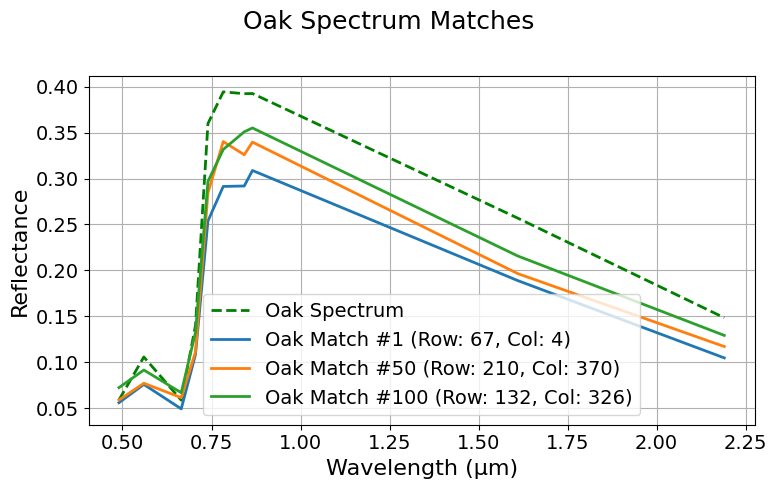

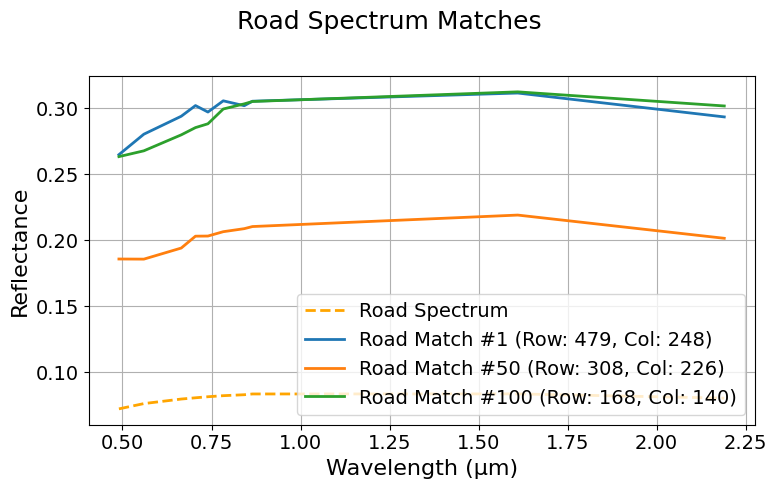

In [16]:
## 4d --> Showing top matches

# Sorting top 100 angles
road_top_indices = np.argsort(road_angles)[:100]
oak_top_indices = np.argsort(oak_angles)[:100]

# Reshape indices back to (row, col) format --> to locate the pixel in original image
road_top_pixels = np.unravel_index(road_top_indices, (num_rows, num_cols))
oak_top_pixels = np.unravel_index(oak_top_indices, (num_rows, num_cols))

# Oak Spectrum Match 
fig_oak, ax_oak = plt.subplots(figsize=(8, 5))
fig_oak.suptitle("Oak Spectrum Matches")

# Plot Sentinel2 Spectral (downsampled) and Top 1st, 50th, and 100th Oak Matches
indices_oak = [0, 49, 99]
ax_oak.plot(Sentinel2_bands, oak_downsampled, label='Oak Spectrum', color='green', linestyle='dashed', linewidth=2)

for i, idx in enumerate(indices_oak): 
    row, col = oak_top_pixels[0][idx], oak_top_pixels[1][idx]   # Select from top_indices
    pixel_spectrum = Sentinal_image_filtered[row, col, :]
    ax_oak.plot(Sentinel2_bands, pixel_spectrum, label=f'Oak Match #{idx + 1} (Row: {row}, Col: {col})', linewidth=2)
ax_oak.set_xlabel('Wavelength (μm)')
ax_oak.set_ylabel('Reflectance')
ax_oak.legend()
ax_oak.grid(True)
fig_oak.tight_layout(rect=[0, 0, 1, 0.98])  
plt.show()

# Road Spectrum Match
fig_road, ax_road = plt.subplots(figsize=(8, 5))
fig_road.suptitle("Road Spectrum Matches")

# Plot Sentinel2 Spectral (downsampled) and Top 1st, 50th, and 100th Road Matches
indices_road = [0, 49, 99]
ax_road.plot(Sentinel2_bands, road_downsampled, label='Road Spectrum', color='orange', linestyle='dashed', linewidth=2)

for i, idx in enumerate(indices_road):  
    row, col = road_top_pixels[0][idx], road_top_pixels[1][idx]
    pixel_spectrum = Sentinal_image_filtered[row, col, :]
    ax_road.plot(Sentinel2_bands, pixel_spectrum, label=f'Road Match #{idx + 1} (Row: {row}, Col: {col})', linewidth=2)
ax_road.set_xlabel('Wavelength (μm)')
ax_road.set_ylabel('Reflectance')
ax_road.legend()
ax_road.grid(True)
fig_road.tight_layout(rect=[0, 0, 1, 0.98])  
plt.show()


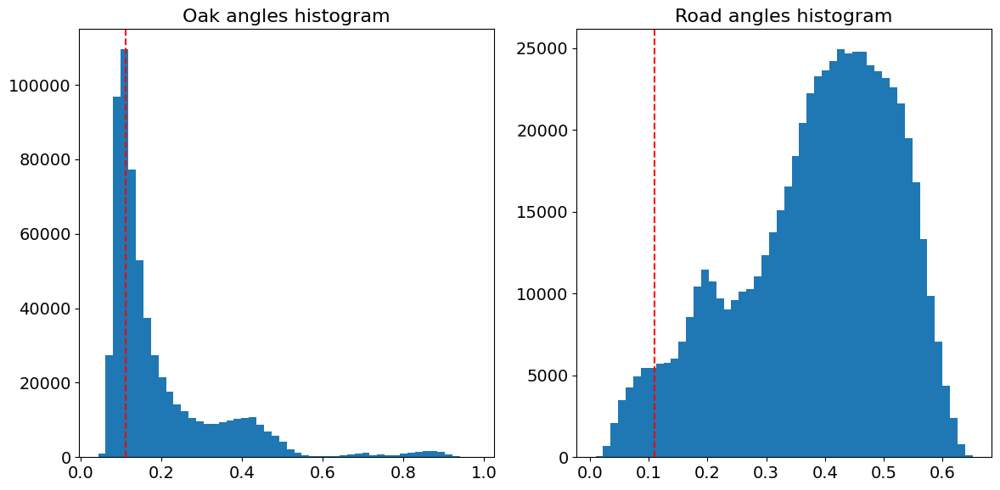

In [17]:
## 4e. Finding best matches in the imagery

## Plot the histogram of SAM

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Manual selection of the thresholds based on visuals
oak_threshold = 0.11
road_threshold = 0.15

# Oak
axes[0].hist(oak_angles, bins=50)
axes[0].axvline(oak_threshold, linestyle='dashed', color='red', label='threshold')
axes[0].set_title("Oak angles histogram")

# Road
axes[1].hist(road_angles, bins=50)
axes[1].axvline(oak_threshold, linestyle='dashed', color='red', label='threshold')
axes[1].set_title(f"Road angles histogram")
plt.tight_layout()
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


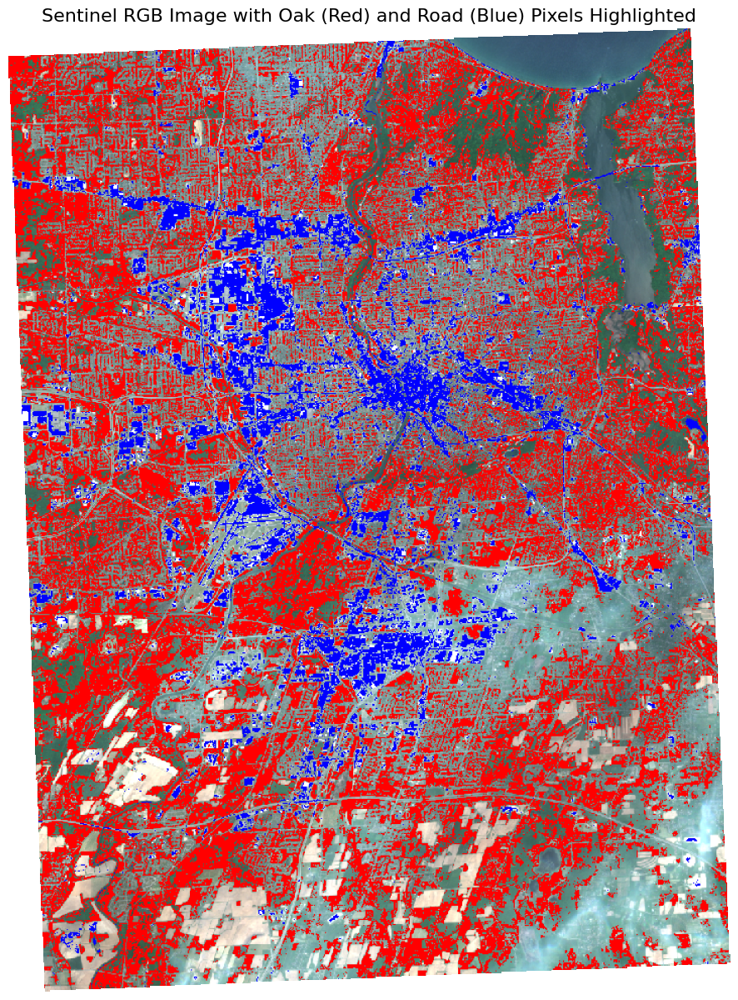

In [18]:
## 4f. Showing in the image:

# Create binary masks based on thresholds for Oak and Road
oak_mask = oak_angles <= oak_threshold
road_mask = road_angles <= road_threshold

# Create a copy of the Sentinel RGB image to visualize the results
highlighted_image = rgb_after.copy()

# Highlight Oak pixels (red color)
highlighted_image[oak_mask.reshape(954, 716)] = [255, 0, 0]  # Red for Oak pixels

# Highlight Road pixels (blue color)
highlighted_image[road_mask.reshape(954, 716)] = [0, 0, 255]  # Blue for Road pixels

# Plot the Sentinel RGB image with highlighted Oak and Road pixels
plt.figure(figsize=(20, 15))
plt.imshow(highlighted_image)
plt.title('Sentinel RGB Image with Oak (Red) and Road (Blue) Pixels Highlighted')
plt.axis('off')  
plt.show()

<div style="font-family: 'TeX Gyre Termes', serif; color: black; font-size: 18px;">

#### **Comments on problem 4: Spectral Angle Mapper (Target Detection)**

The sections *4a to 4f* show the application of **SAM** to find target spectrum match in the imagery for two targets *vegetation (Oak) and Road (Construction Asphalt)*. The explanantion of each section is given below:

- **Section 4a:** In section 4a the target spectrums are imported from the given source.
- **Section 4b:** In section 4b the target spectrums are downsampled to match the Sentinel2 bands as per the instructions provided for inclusion or exclusion of bands.
- **Section 4c:** In section 4c **SAM score** between each pixel in the Sentinel2 imagery and each target is calculated. **SAM** calculates the *cosine angle* as scores between the two vectors and the pixel(vector) with lowest angle can be considered as the highest match. So we calculated all **SAM** scores for both targets using the program written in this section.
- **Section 4d:** In section 4d the best *1st, 50th and 100th* match pixel for each target is determined and plotted against the actual spectrums. It is to be noted that **SAM** measures the shape-match between the vectors and magnitude doesnt matter in the match. So the pixels which have best shape match will be considered as the target pixel even if the magnitude is different. This can also be seen in the difference in between magnitude of top *1st, 50th and 100th* matches, where best *100th* match pixel is closer than best *1st* match in terms of magnitude, however in terms of shape match *1st* one is better.
- **Section 4e:** In section 4e the histogram of **SAM** scores is plotted for both target and a *lower cut-off* value is choosen below which we assume the match is good. This cut off is subjective and depends on each persons choice.
- **Section 4f:** Finally we plotted all the pixels based on the histogram cut-off values, where we think the targets are and plotted those target pixels over the RGB image to show the detected targets.
*Oak* is shown in *red* pixels while *road* is shown in *blue* pixels. The figure shows how a simple algorithm can be used efficiently for detecting targets in multispectral imagery. There are missing pixels in the imagery due to presence of clouds and other reasons but still the result looks good.

</div>